In [1]:
import imp
import os
import logging

import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import plotly

from BuildingControlsSimulator.Simulator.Simulation import Simulation
from BuildingControlsSimulator.BuildingModels.IDFPreprocessor import IDFPreprocessor
from BuildingControlsSimulator.BuildingModels.EnergyPlusBuildingModel import EnergyPlusBuildingModel
from BuildingControlsSimulator.ControlModels.FMIController import FMIController
from BuildingControlsSimulator.ControlModels.Deadband import Deadband

plotly.offline.init_notebook_mode(connected=True)
%load_ext autoreload
%autoreload 2


# Simulation with FMU bundled C++ implemented deadband controller

In [2]:
s = Simulation(
    building_model=EnergyPlusBuildingModel(
        idf=IDFPreprocessor(
            idf_file="AZ_Phoenix_gasfurnace_crawlspace_IECC_2018_cycles.idf",
            init_temperature=22.),
        weather_file="USA_AZ_Phoenix-Sky.Harbor.Intl.AP.722780_TMY3.epw"
    ),
    controller_model=FMIController(fmu_path="../test/fmu/fmu-models/deadband/deadband.fmu", deadband=3, stp_heat=21., stp_cool=24.),
    step_size_minutes=5,
    start_time_days = 182,
    final_time_days = 212,
)

In [3]:
%%time
s.create_models()

/home/bcs/lib/external/EnergyPlus/EnergyPlus-8-9-0/PreProcess/IDFVersionUpdater/V8-9-0-Energy+.idd
CPU times: user 439 ms, sys: 28.3 ms, total: 467 ms
Wall time: 14.7 s


'/home/bcs/lib/building-controls-simulator/fmu/v8-9-0/AZ_Phoenix_gasfurnace_crawlspace_IECC_2018_cycles_prep.fmu'

In [4]:
%%time
output_df_fmi = s.run()

CPU times: user 9.33 s, sys: 1.13 s, total: 10.5 s
Wall time: 45 s


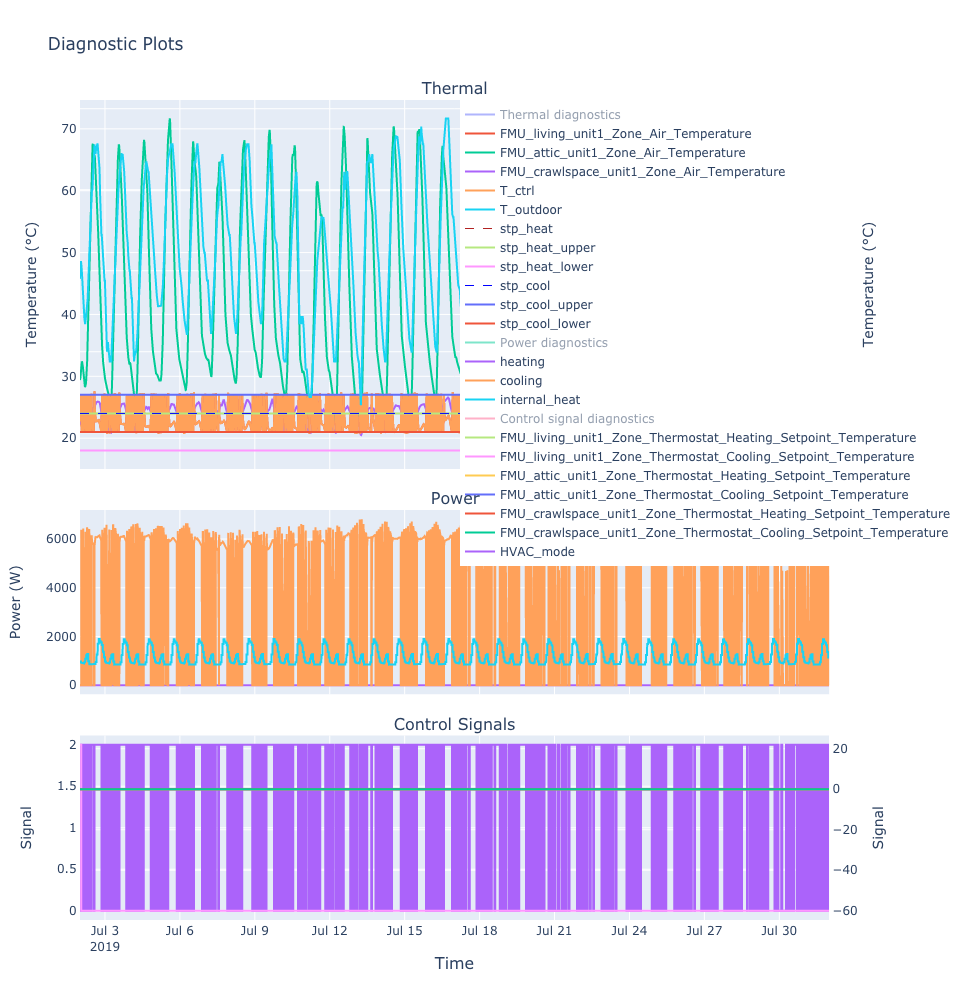

CPU times: user 8.91 s, sys: 72.9 ms, total: 8.98 s
Wall time: 9.02 s


In [5]:
%%time
s.show_plots()

In [6]:
hvac_df = output_df_fmi[["time_seconds", "HVAC_mode"]].copy(deep=True)
hvac_df["HVAC_mode_prev"] = hvac_df.HVAC_mode.shift(periods=1)
hvac_mode_changes = hvac_df[hvac_df.HVAC_mode_prev != hvac_df.HVAC_mode].copy(deep=True)
hvac_mode_changes["time_seconds_prev"] = hvac_mode_changes.time_seconds.shift(periods=1)
hvac_mode_changes["time_delta"] = hvac_mode_changes["time_seconds"] - hvac_mode_changes["time_seconds_prev"]

total runtime (s): 1606200.0
mean HVAC on-cycle length (s): 6323.622047244095


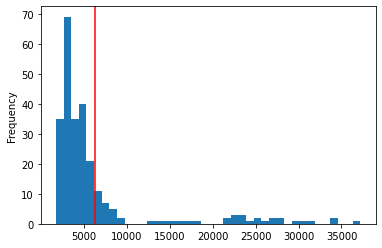

In [7]:
on_cycles = hvac_mode_changes[hvac_mode_changes.HVAC_mode == 0].time_delta
plt = on_cycles.plot.hist(bins=40)
plt.axvline(x=on_cycles.mean(), color='r')
print("total runtime (s): {}".format(on_cycles.sum()))
print("mean HVAC on-cycle length (s): {}".format(on_cycles.mean()))

mean HVAC off-cycle length: 3876.3779527559054


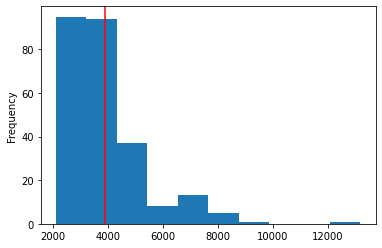

In [8]:
off_cycles = hvac_mode_changes[hvac_mode_changes.HVAC_mode == 2].time_delta
plt = off_cycles.plot.hist()
plt.axvline(x=off_cycles.mean(), color='r')
print("mean HVAC off-cycle length: {}".format(off_cycles.mean()))

# Simulation with python implemented deadband controller

In [9]:
s = Simulation(
    building_model=EnergyPlusBuildingModel(
        idf=IDFPreprocessor(
            idf_file="AZ_Phoenix_gasfurnace_crawlspace_IECC_2018_cycles.idf",
            init_temperature=22.),
        weather_file="USA_AZ_Phoenix-Sky.Harbor.Intl.AP.722780_TMY3.epw"
    ),
    controller_model=Deadband(deadband=3, stp_heat=21., stp_cool=24.),
    step_size_minutes=5,
    start_time_days = 182,
    final_time_days = 212,
)

In [10]:
%%time
s.create_models(preprocess_check=True)

/home/bcs/lib/external/EnergyPlus/EnergyPlus-8-9-0/PreProcess/IDFVersionUpdater/V8-9-0-Energy+.idd
CPU times: user 419 ms, sys: 33.6 ms, total: 453 ms
Wall time: 11.1 s


'/home/bcs/lib/building-controls-simulator/fmu/v8-9-0/AZ_Phoenix_gasfurnace_crawlspace_IECC_2018_cycles_prep.fmu'

In [11]:
%%time
output_df_python = s.run()

CPU times: user 7.98 s, sys: 998 ms, total: 8.97 s
Wall time: 39.5 s


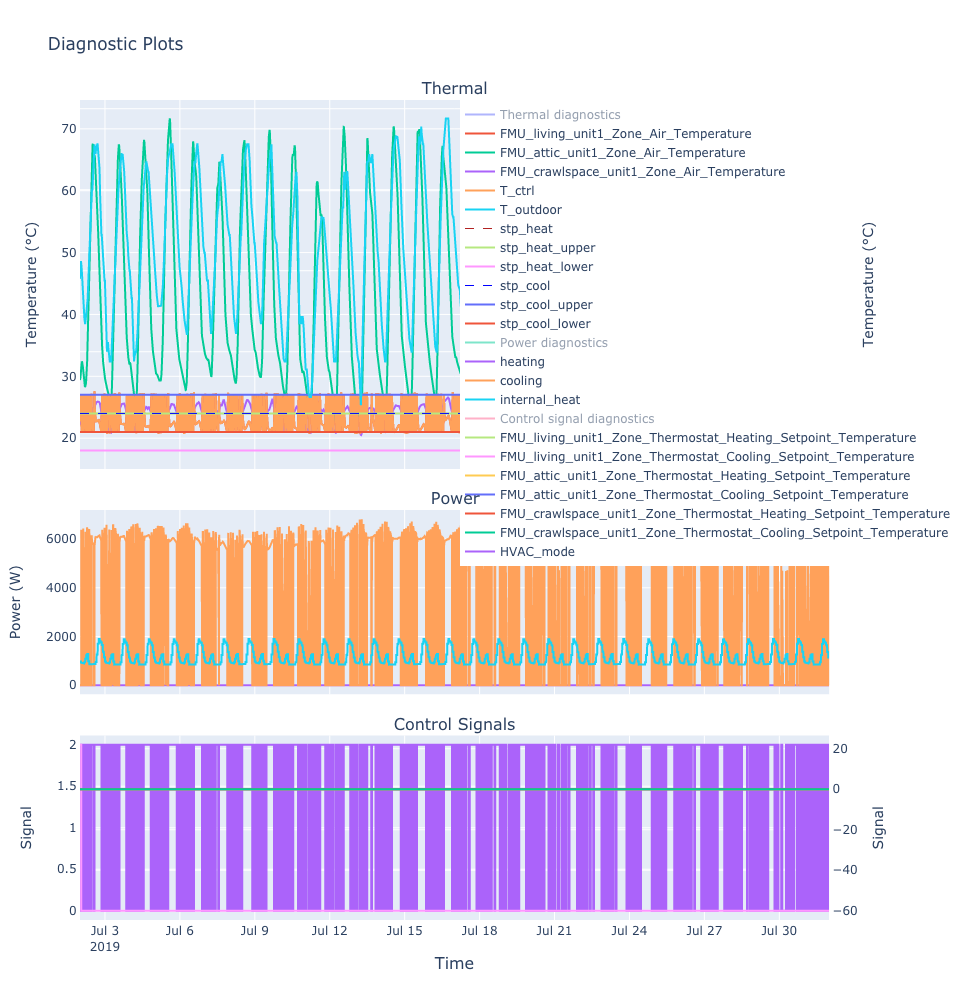

CPU times: user 8.86 s, sys: 65.6 ms, total: 8.93 s
Wall time: 8.94 s


In [12]:
%%time
s.show_plots()

In [13]:
hvac_df = output_df_python[["time_seconds", "HVAC_mode"]].copy(deep=True)
hvac_df["HVAC_mode_prev"] = hvac_df.HVAC_mode.shift(periods=1)
hvac_mode_changes = hvac_df[hvac_df.HVAC_mode_prev != hvac_df.HVAC_mode].copy(deep=True)
hvac_mode_changes["time_seconds_prev"] = hvac_mode_changes.time_seconds.shift(periods=1)
hvac_mode_changes["time_delta"] = hvac_mode_changes["time_seconds"] - hvac_mode_changes["time_seconds_prev"]

total runtime (s): 1606200.0
mean HVAC on-cycle length (s): 6323.622047244095


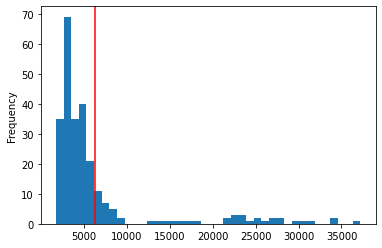

In [14]:
on_cycles = hvac_mode_changes[hvac_mode_changes.HVAC_mode == 0].time_delta
plt = on_cycles.plot.hist(bins=40)
plt.axvline(x=on_cycles.mean(), color='r')
print("total runtime (s): {}".format(on_cycles.sum()))
print("mean HVAC on-cycle length (s): {}".format(on_cycles.mean()))

total runtime (s): 1606200.0
mean HVAC on-cycle length (s): 6323.622047244095


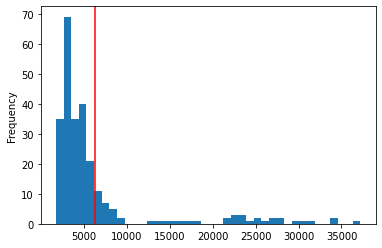

In [15]:
on_cycles = hvac_mode_changes[hvac_mode_changes.HVAC_mode == 0].time_delta
plt = on_cycles.plot.hist(bins=40)
plt.axvline(x=on_cycles.mean(), color='r')
print("total runtime (s): {}".format(on_cycles.sum()))
print("mean HVAC on-cycle length (s): {}".format(on_cycles.mean()))

# Output equivalence

In [16]:
output_df_python.equals(output_df_fmi)

True